loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Olive-Detection-4 in yolov8:: 100%|██████████| 3404/3404 [00:00<00:00, 3998.56it/s]


/content/datasets
100% 21.5M/21.5M [00:00<00:00, 208MB/s]
New https://pypi.org/project/ultralytics/8.1.29 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/Olive-Detection-4/data.yaml, epochs=70, patience=50, batch=16, imgsz=600, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, strea

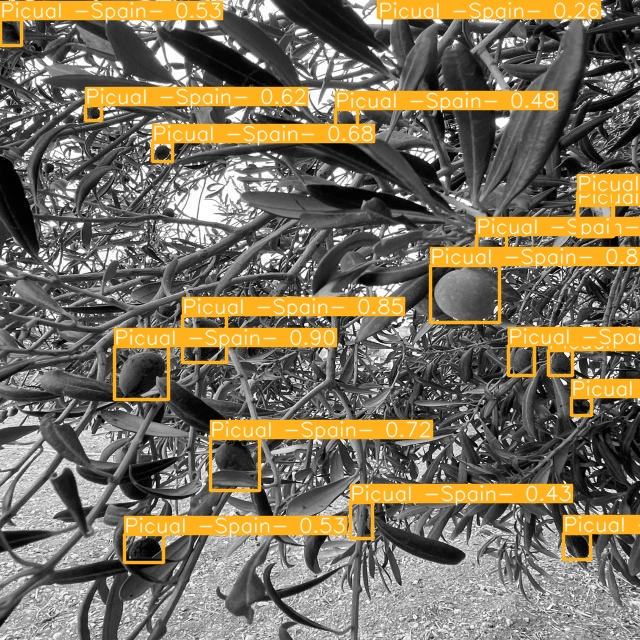

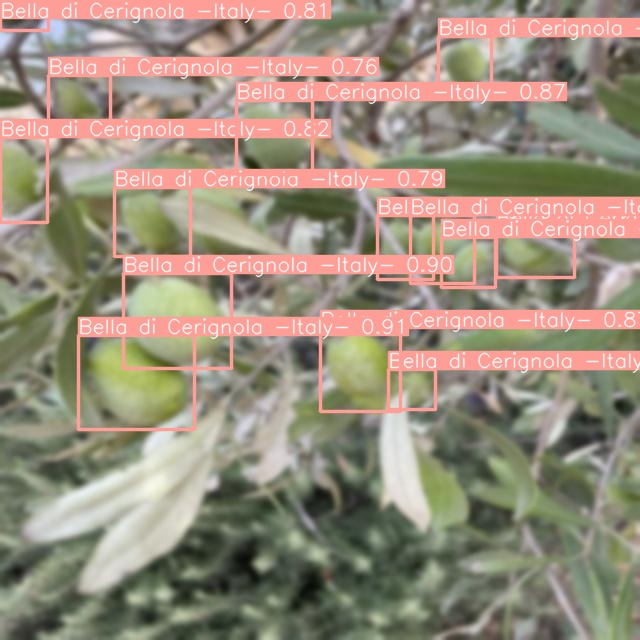

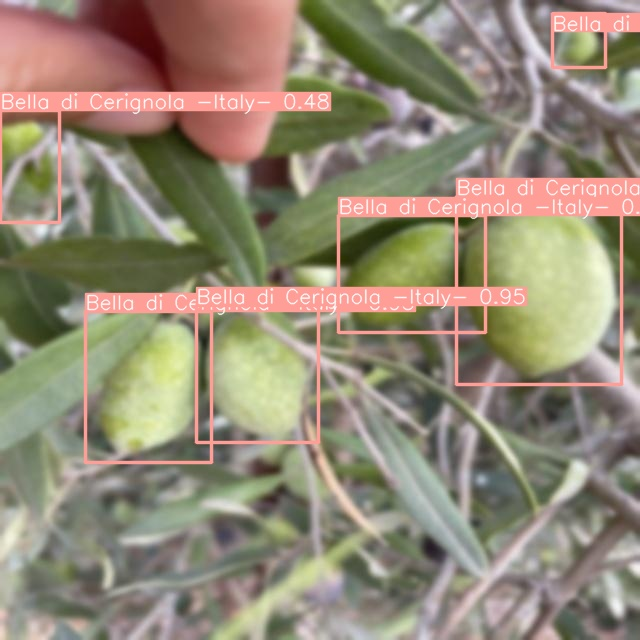

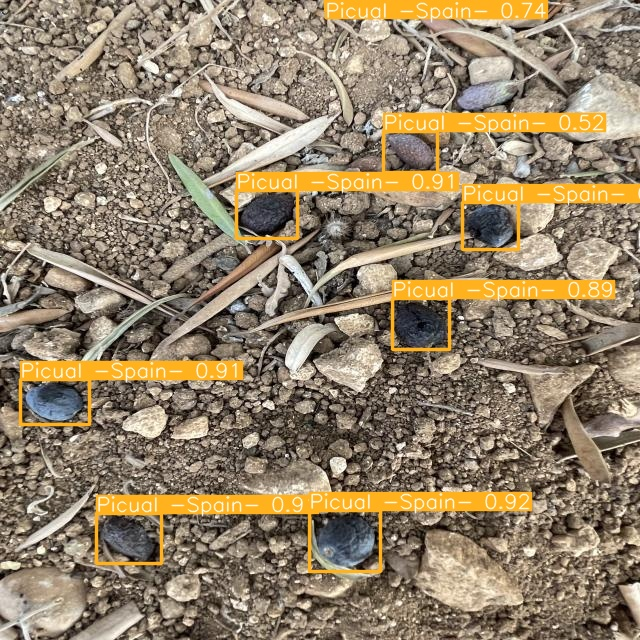

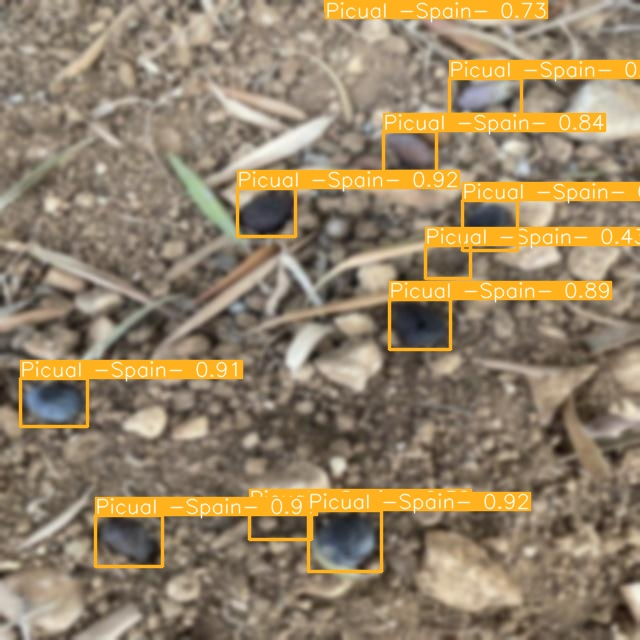

...

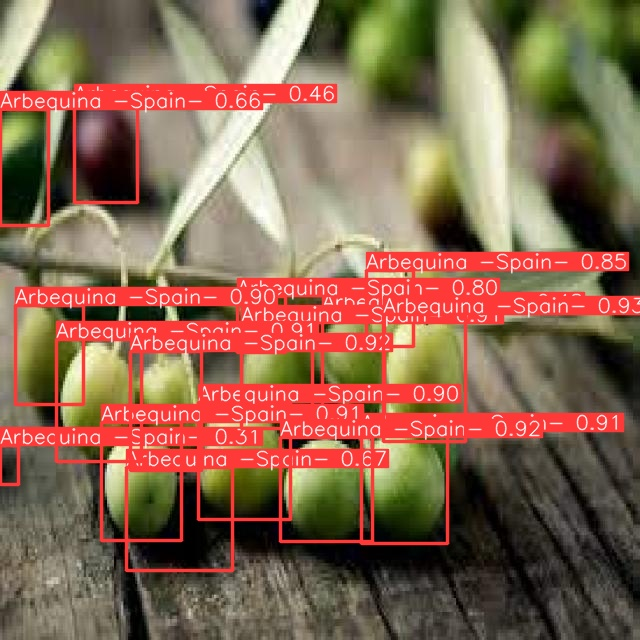

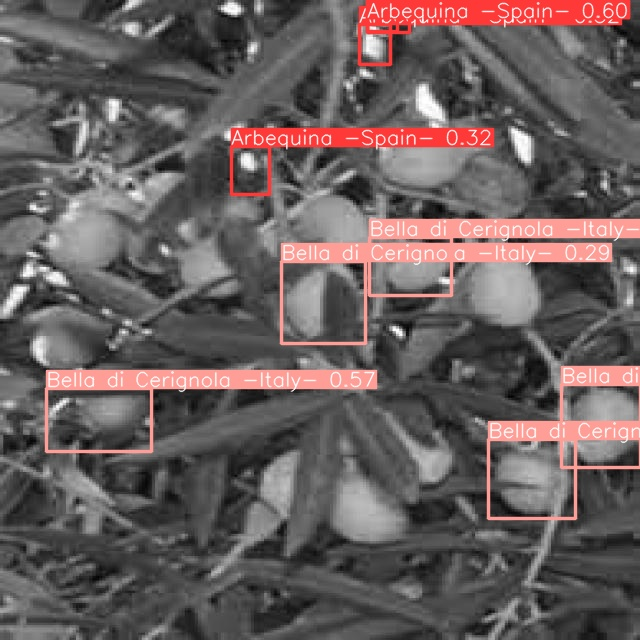

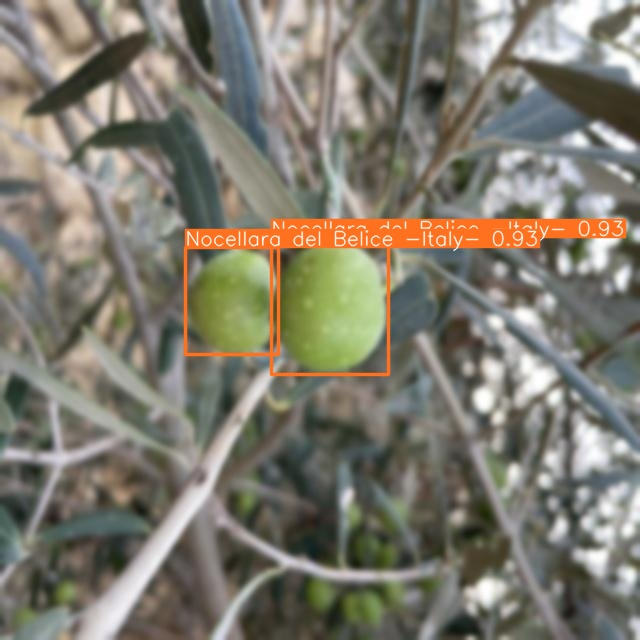

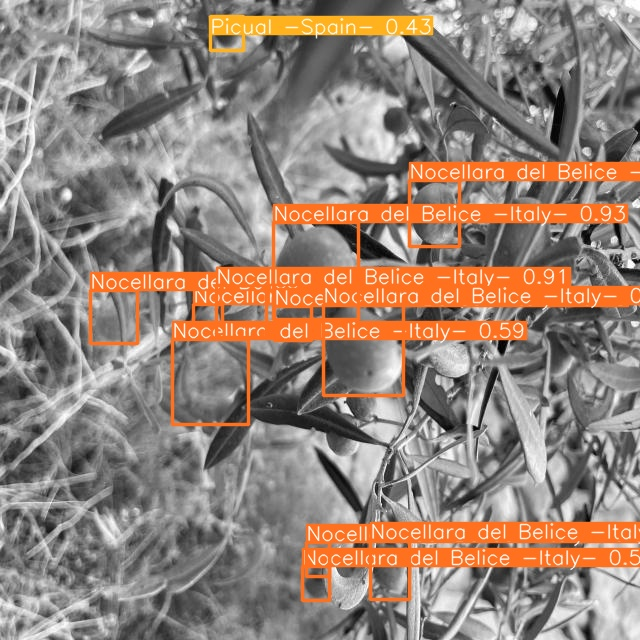

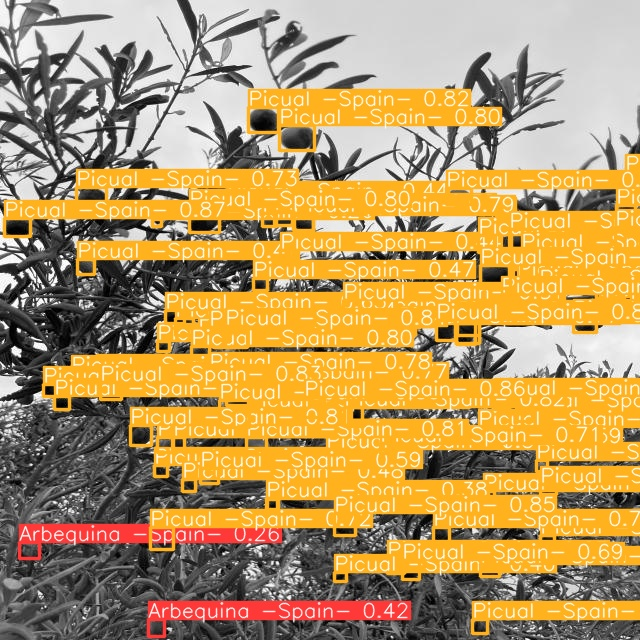

<IPython.core.display.Javascript object>

In [ ]:
# Installation of necessary libraries
!pip install ultralytics==8.0.196  # Check for the correct version of Ultralytics YOLO
!pip install roboflow

# Importing necessary modules
from ultralytics import YOLO
from roboflow import Roboflow

# Clear any previous output (optional, for cleanliness)
from IPython.display import clear_output
clear_output()

# Setup your Roboflow project (replace placeholders with your actual API key, workspace, and project)
rf = Roboflow(api_key="UUyg1uqGrAMeSVtpzCNH")
project = rf.workspace("mcast-ywuvt").project("olive-detection-oqcgz")
version = project.version(4)
dataset = version.download("yolov8")

# Configuring YOLO for custom training
!mkdir -p ./datasets
%cd ./datasets

# Adjust parameters as needed (model, data path, epochs, image size, batch size, learning rate, etc.)
!yolo task=detect mode=train model=yolov8s.pt data={dataset.location}/data.yaml epochs=70 imgsz=600 plots=True batch=16 lr0=0.001

# Change directory back to the home directory after training
%cd ..

# Evaluation step: Ensure you're using the correct path to your trained model weights
!yolo task=detect mode=val model=/content/datasets/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

# Prediction on test images: Adjust the source path to your dataset's test images
!yolo task=detect mode=predict model=/content/datasets/runs/detect/train/weights/best.pt source={dataset.location}/test/images save=True

# Display some of the prediction results
import glob
from IPython.display import Image, display

for image_path in glob.glob('./runs/detect/predict/*.jpg')[:100]:  # Adjust the number of images as needed
    display(Image(filename=image_path))

# Ensure all necessary packages are up to date for compatibility
!pip install -U torch torchvision

# Start TensorBoard
%load_ext tensorboard
%tensorboard --logdir /content/datasets/runs/detect/train


In [ ]:
!zip -r project.zip /content

  adding: content/ (stored 0%)
  adding: content/.config/ (stored 0%)
  adding: content/.config/.last_survey_prompt.yaml (stored 0%)
  adding: content/.config/default_configs.db (deflated 98%)
  adding: content/.config/configurations/ (stored 0%)
  adding: content/.config/configurations/config_default (deflated 15%)
  adding: content/.config/config_sentinel (stored 0%)
  adding: content/.config/logs/ (stored 0%)
  adding: content/.config/logs/2024.03.18/ (stored 0%)
  adding: content/.config/logs/2024.03.18/13.23.23.345989.log (deflated 58%)
  adding: content/.config/logs/2024.03.18/13.23.04.553556.log (deflated 58%)
  adding: content/.config/logs/2024.03.18/13.22.38.230460.log (deflated 91%)
  adding: content/.config/logs/2024.03.18/13.23.33.987202.log (deflated 57%)
  adding: content/.config/logs/2024.03.18/13.23.15.230060.log (deflated 86%)
  adding: content/.config/logs/2024.03.18/13.23.34.758991.log (deflated 56%)
  adding: content/.config/.last_opt_in_prompt.yaml (stored 0%)
  ad